In [154]:
import numpy as np
import os
from scipy import ndarray

import skimage as sk
from skimage import transform
from skimage import util
from skimage import io
import imageio

from numpy import linalg as LA
from scipy.sparse import csc_matrix,coo_matrix
from scipy.sparse.linalg import svds, eigs
from sklearn.decomposition import PCA,TruncatedSVD
import pickle
import pandas as pd
from random import randint
import random

import umap
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN, KMeans, AffinityPropagation, MeanShift
from sklearn.preprocessing import MinMaxScaler
import kmapper as km
from kmapper.cover import Cover
from sklearn.datasets import fetch_mldata
from sklearn.decomposition import PCA
import hdbscan
import sklearn.cluster as cluster
from sklearn.metrics import adjusted_rand_score, adjusted_mutual_info_score

import networkx as nx
from community import best_partition # this is not part of networkx

import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from matplotlib.colors import ListedColormap
from scipy import ndimage
import imageio
import plotly
import plotly.graph_objs as go

def bbox(img):
    rows = np.any(img, axis=1)
    cols = np.any(img, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]

    return rmin, rmax, cmin, cmax    
def embedding(data,dim):
    projection = mapper.fit_transform(data, projection=umap.UMAP(n_components=dim, n_neighbors=200, 
                                             a=None, angular_rp_forest=False, b=None, init='spectral',
                                           learning_rate=1.0, local_connectivity=1.0, metric='euclidean',
                                           metric_kwds=None, min_dist=0.1, n_epochs=500,
                                           negative_sample_rate=10, random_state=47,
                                           repulsion_strength=1.0, set_op_mix_ratio=0.5, spread=0.25,
                                           target_metric='categorical', target_metric_kwds=None,
                                           target_n_neighbors=-1, target_weight=0.5, transform_queue_size=10.0,
                                           transform_seed=42, verbose=False))
    return projection

def random_rotation(image_array):
    # pick a random degree of rotation between 25% on the left and 25% on the right
    random_degree = random.uniform(-25, 25)
    return sk.transform.rotate(image_array, random_degree)

def rotation(image_array, degree):
    return sk.transform.rotate(image_array, degree)

def random_noise(image_array):
    # add random noise to the image
    return sk.util.random_noise(image_array)

def horizontal_flip(image_array):
    # horizontal flip doesn't need skimage, it's easy as flipping the image array of pixels !
    return image_array[:, ::-1]

def bbox(img):
    rows = np.any(img, axis=1)
    cols = np.any(img, axis=0)
    rmin, rmax = np.where(rows)[0][[0, -1]]
    cmin, cmax = np.where(cols)[0][[0, -1]]

    return rmin, rmax, cmin, cmax    

def pad_with(vector, pad_width, iaxis, kwargs):
    pad_value = kwargs.get('padder', 0)
    vector[:pad_width[0]] = pad_value
    vector[-pad_width[1]:] = pad_value
    
def augmentation(folder_path,augmented_folder_path,num_unique_cells,angle_step):
    images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]
    for cell in range(num_unique_cells):
        path = '%s/cell_%s' % (augmented_folder_path,cell)
        if not os.path.isdir(path): 
            os.mkdir(path)
        else:
            pass

#         print('Augmenting cell '+str(cell)+' in '+folder_path)
        image_path = images[cell]
        img = imageio.imread(image_path)
        rmin, rmax, cmin, cmax = bbox(img)
        image_to_transform = np.pad(img[rmin:rmax,cmin:cmax], 2, pad_with, padder=0)  

        rotation_angle = 0
        transformed_image = None
        while rotation_angle <= 360:
            transformed_image = rotation(image_to_transform, rotation_angle)
            new_file_path = '%s/cell_%s/angle_%s.jpg' % (augmented_folder_path,cell,rotation_angle)
            io.imsave(new_file_path, transformed_image)
            transformed_image = horizontal_flip(transformed_image)
            new_file_path = '%s/cell_%s/angle_%s_flipped.jpg' % (augmented_folder_path,cell,rotation_angle)
            io.imsave(new_file_path, transformed_image)
            rotation_angle += angle_step

In [260]:
'''Generate for each of the unique cell type, all rotated and flipped copies. 
The usefulnes of this could be related to the possibility of connecting in the high dimensional space
images that would be otherwise sparsely displaced - curse of dimensionality - and difficult to cluster. 
It is a way of better sensing the low-dimensional manifold structure of the HD representation.'''

num_unique_cells = 1000
angle_step = 30

folder_path = '/home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52'
augmented_folder_path = '/home/garner1/Work/dataset/cellImages/image52/augmented'
augmentation(folder_path,augmented_folder_path,num_unique_cells,angle_step)

Augmenting cell 0 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 1 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 2 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 3 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 4 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 5 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 6 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 7 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 8 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 9 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 10 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 11 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 12 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 13 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 14 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 15 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 16 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 17 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 18 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 19 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 20 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 21 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 22 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 23 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 24 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 25 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 26 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 27 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 28 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 29 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 30 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 31 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 32 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 33 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 34 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 35 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 36 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 37 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 38 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 39 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 40 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 41 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 42 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 43 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 44 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 45 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 46 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 47 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 48 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 49 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 50 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 51 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 52 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 53 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 54 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 55 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 56 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 57 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 58 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 59 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 60 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 61 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 62 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 63 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 64 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 65 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 66 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 67 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 68 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 69 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 70 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 71 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 72 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 73 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 74 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 75 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 76 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 77 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 78 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 79 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 80 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 81 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 82 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 83 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 84 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 85 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 86 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 87 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 88 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 89 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 90 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 91 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 92 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 93 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 94 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 95 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 96 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 97 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 98 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 99 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 100 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 101 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 102 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 103 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 104 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 105 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image5

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 106 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 107 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 108 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 109 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 110 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 111 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 112 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 113 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 114 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 115 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 116 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 117 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 118 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 119 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 120 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 121 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 122 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 123 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 124 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 125 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 126 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 127 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 128 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 129 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 130 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 131 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 132 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 133 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 134 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 135 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 136 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 137 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 138 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 139 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 140 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 141 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 142 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 143 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 144 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 145 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 146 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 147 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 148 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 149 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 150 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 151 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 152 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 153 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 154 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 155 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 156 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 157 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 158 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 159 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 160 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 161 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 162 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 163 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 164 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 165 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 166 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 167 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 168 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 169 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 170 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 171 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 172 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 173 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 174 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 175 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 176 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 177 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 178 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 179 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 180 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 181 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 182 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 183 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 184 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 185 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 186 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 187 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 188 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 189 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 190 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 191 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 192 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 193 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 194 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 195 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 196 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 197 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 198 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 199 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 200 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 201 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 202 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 203 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 204 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 205 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 206 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 207 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 208 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 209 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 210 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 211 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 212 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 213 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 214 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 215 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 216 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 217 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 218 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 219 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 220 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 221 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 222 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 223 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 224 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 225 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 226 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 227 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 228 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 229 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 230 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 231 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 232 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 233 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 234 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 235 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 236 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 237 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 238 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 239 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 240 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 241 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 242 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 243 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 244 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 245 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 246 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 247 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 248 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 249 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 250 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 251 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 252 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 253 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 254 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 255 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 256 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 257 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 258 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 259 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 260 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 261 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 262 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 263 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 264 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 265 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 266 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 267 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 268 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 269 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 270 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 271 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 272 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 273 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 274 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 275 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 276 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 277 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 278 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 279 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 280 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 281 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 282 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 283 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 284 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 285 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 286 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 287 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 288 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 289 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 290 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 291 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 292 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 293 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 294 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 295 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 296 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 297 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 298 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 299 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 300 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 301 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 302 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 303 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 304 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 305 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 306 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 307 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 308 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 309 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 310 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 311 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 312 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 313 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 314 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 315 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 316 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 317 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 318 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 319 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 320 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 321 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 322 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 323 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 324 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 325 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 326 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 327 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 328 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 329 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 330 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 331 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 332 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 333 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 334 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 335 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 336 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 337 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 338 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 339 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 340 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 341 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 342 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 343 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 344 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 345 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 346 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 347 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 348 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 349 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 350 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 351 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 352 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 353 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 354 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 355 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 356 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 357 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 358 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 359 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 360 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 361 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 362 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 363 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 364 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 365 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 366 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 367 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 368 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 369 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 370 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 371 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 372 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 373 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 374 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 375 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 376 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 377 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 378 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 379 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 380 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 381 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 382 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 383 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 384 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 385 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 386 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 387 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 388 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 389 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 390 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 391 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 392 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 393 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 394 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 395 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 396 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 397 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 398 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 399 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 400 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 401 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 402 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 403 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 404 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 405 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 406 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 407 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 408 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 409 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 410 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 411 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 412 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 413 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 414 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 415 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 416 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 417 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 418 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 419 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 420 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 421 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 422 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 423 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 424 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 425 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 426 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 427 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 428 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 429 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 430 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 431 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 432 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 433 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 434 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 435 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 436 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 437 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 438 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 439 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 440 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 441 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 442 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 443 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 444 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 445 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 446 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 447 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 448 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 449 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 450 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 451 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 452 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 453 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 454 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 455 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 456 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 457 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 458 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 459 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 460 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 461 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 462 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 463 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 464 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 465 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 466 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 467 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 468 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 469 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 470 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 471 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 472 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 473 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 474 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 475 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 476 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 477 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 478 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 479 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 480 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 481 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 482 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 483 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 484 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 485 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 486 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 487 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 488 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 489 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 490 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 491 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 492 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 493 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 494 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 495 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 496 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 497 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 498 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 499 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 500 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 501 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 502 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 503 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 504 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 505 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 506 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 507 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 508 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 509 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 510 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 511 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 512 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 513 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 514 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 515 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 516 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 517 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 518 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 519 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 520 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 521 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 522 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 523 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 524 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 525 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 526 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 527 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 528 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 529 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 530 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 531 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 532 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 533 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 534 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 535 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 536 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 537 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 538 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 539 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 540 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 541 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 542 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 543 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 544 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 545 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 546 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 547 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 548 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 549 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 550 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 551 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 552 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 553 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 554 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 555 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 556 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 557 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 558 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 559 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 560 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 561 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 562 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 563 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 564 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 565 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 566 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 567 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 568 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 569 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 570 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 571 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 572 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 573 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 574 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 575 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 576 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 577 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 578 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 579 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 580 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 581 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 582 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 583 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 584 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 585 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 586 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 587 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 588 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 589 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 590 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 591 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 592 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 593 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 594 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 595 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 596 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 597 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 598 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 599 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 600 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 601 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 602 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 603 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 604 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 605 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 606 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 607 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 608 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 609 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 610 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 611 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 612 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 613 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 614 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 615 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 616 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 617 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 618 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 619 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 620 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 621 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 622 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 623 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 624 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 625 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 626 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 627 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 628 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 629 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 630 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 631 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 632 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 633 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 634 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 635 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 636 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 637 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 638 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 639 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 640 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 641 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 642 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 643 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 644 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 645 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 646 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 647 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 648 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 649 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 650 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 651 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 652 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 653 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 654 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 655 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 656 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 657 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 658 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 659 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 660 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 661 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 662 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 663 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 664 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 665 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 666 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 667 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 668 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 669 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 670 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 671 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 672 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 673 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 674 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 675 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 676 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 677 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 678 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 679 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 680 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 681 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 682 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 683 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 684 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 685 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 686 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 687 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 688 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 689 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 690 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 691 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 692 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 693 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 694 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 695 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 696 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 697 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 698 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 699 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 700 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 701 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 702 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 703 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 704 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 705 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 706 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 707 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 708 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 709 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 710 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 711 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 712 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 713 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 714 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 715 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 716 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 717 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 718 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 719 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 720 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 721 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 722 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 723 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 724 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 725 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 726 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 727 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 728 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 729 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 730 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 731 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 732 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 733 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 734 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 735 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 736 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 737 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 738 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 739 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 740 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 741 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 742 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 743 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 744 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 745 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 746 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 747 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 748 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 749 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 750 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 751 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 752 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 753 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 754 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 755 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 756 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 757 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 758 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 759 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 760 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 761 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 762 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 763 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 764 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 765 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 766 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 767 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 768 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 769 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 770 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 771 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 772 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 773 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 774 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 775 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 776 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 777 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 778 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 779 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 780 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 781 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 782 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 783 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 784 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 785 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 786 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 787 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 788 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 789 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 790 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 791 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 792 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 793 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 794 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 795 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 796 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 797 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 798 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 799 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 800 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 801 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 802 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 803 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 804 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 805 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 806 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 807 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 808 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 809 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 810 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 811 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 812 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 813 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 814 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 815 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 816 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 817 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 818 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 819 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 820 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 821 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 822 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 823 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 824 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 825 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 826 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 827 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 828 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 829 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 830 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 831 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 832 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 833 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 834 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 835 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 836 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 837 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 838 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 839 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 840 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 841 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 842 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 843 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 844 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 845 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 846 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 847 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 848 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 849 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 850 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 851 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 852 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 853 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 854 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 855 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 856 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 857 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 858 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 859 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 860 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 861 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 862 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 863 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 864 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 865 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 866 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 867 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 868 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 869 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 870 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 871 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 872 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 873 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 874 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 875 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 876 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 877 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 878 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 879 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 880 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 881 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 882 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 883 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 884 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 885 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 886 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 887 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 888 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 889 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 890 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 891 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 892 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 893 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 894 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 895 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 896 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 897 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 898 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 899 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 900 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 901 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 902 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 903 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 904 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 905 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 906 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 907 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 908 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 909 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 910 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 911 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 912 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 913 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 914 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 915 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 916 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 917 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 918 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 919 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 920 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 921 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 922 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 923 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 924 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 925 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 926 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 927 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 928 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 929 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 930 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 931 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 932 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 933 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 934 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 935 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 936 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 937 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 938 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 939 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 940 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 941 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 942 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 943 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 944 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 945 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 946 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 947 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 948 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 949 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 950 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 951 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 952 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 953 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 954 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 955 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 956 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 957 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 958 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 959 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 960 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 961 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 962 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 963 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 964 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 965 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 966 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 967 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 968 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 969 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 970 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 971 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 972 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 973 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 974 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 975 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 976 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 977 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 978 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 979 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 980 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 981 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 982 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 983 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 984 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 985 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52


/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

Augmenting cell 986 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 987 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 988 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 989 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 990 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 991 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 992 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 993 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 994 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 995 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 996 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_Image52
Augmenting cell 997 in /home/garner1/Work/dataset/cellImages/image52/Nuclei_

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-packages/skimage/util/dtype.py:141: UserWarning:

Possible precision loss when converting from float64 to uint8

/usr/local/share/anaconda2/lib/python2.7/site-

In [261]:
'''Loading the data'''
widths = []
heights = []
target = []
directories = ['/home/garner1/Work/dataset/cellImages/training/augmented/Cancer',
               '/home/garner1/Work/dataset/cellImages/training/augmented/Immuno',
              '/home/garner1/Work/dataset/cellImages/training/augmented/Other',
               '/home/garner1/Work/dataset/cellImages/image52/augmented']
'''Box each nucleus'''
cell_labels = []
target_id = 0
for directory in directories:
    target_id += 1
    cell_id = 0
    for cell in os.listdir(directory)[:num_unique_cells]:
        path = os.path.join(directory, cell)
        cell_id += 1
        for img in os.listdir(path):
            filename = os.path.join(path, img)
            img = imageio.imread(filename)
            rmin, rmax, cmin, cmax = bbox(img)
            width = rmax-rmin
            height = cmax-cmin
            widths.append(width)
            heights.append(height)
            target.append(target_id)    
            cell_labels.append(cell_id)
        
            
'''Resizing images to small boxes'''
Mwidths = max(widths)
Mheights = max(heights)
images = []
for directory in directories:
    for cell in os.listdir(directory)[:num_unique_cells]:
        path = os.path.join(directory, cell)
        for img in os.listdir(path):
            filename = os.path.join(path, img)
            img = imageio.imread(filename)
            rmin, rmax, cmin, cmax = bbox(img)
            padwidth = int(Mwidths-(rmax-rmin))
            padheight = int(Mheights-(cmax-cmin))
            newimg = np.pad(img[rmin:rmax,cmin:cmax],((0,padwidth),(0,padheight)),'constant', constant_values=(0))
            images.append(newimg)

data = np.zeros((Mwidths*Mheights,len(images)))
for ind in range(len(images)): data[:,ind] = images[ind].flatten() # from 2D arrays to 1D arrays
data = data.transpose()

print(data.shape)

(71576, 1974)


In [262]:
'''2D embedding'''
n_neighbors = 30
d2_embedding = umap.UMAP(n_neighbors=n_neighbors,min_dist=0.0,n_components=2,random_state=42).fit_transform(data)

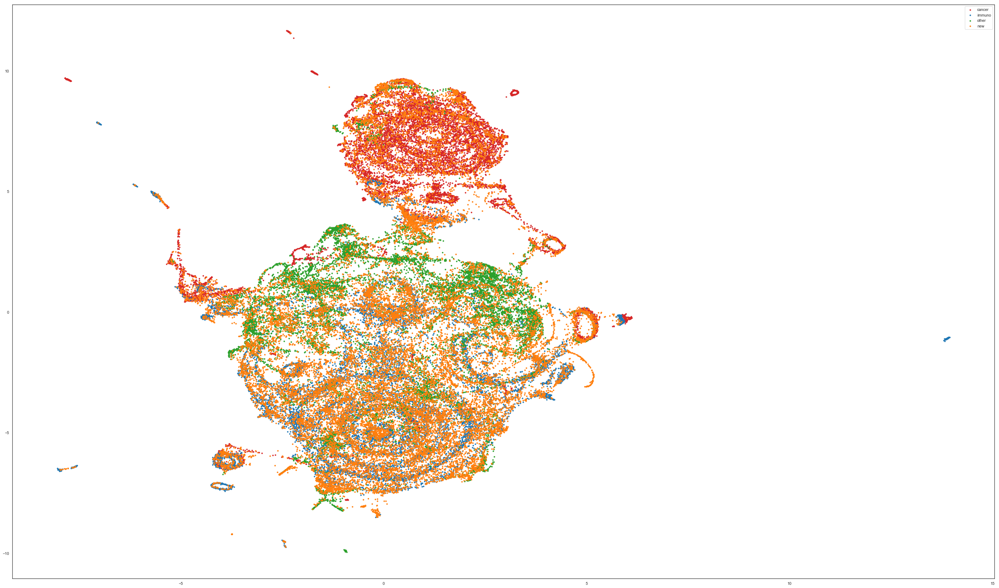

In [263]:
'''2D Visualization'''
fig, ax = plt.subplots()
colors = ['tab:red', 'tab:blue', 'tab:green', 'tab:orange']
labels = ['cancer','immuno','other','new']

cancer = (np.asarray(target) == 1)
ax.scatter(d2_embedding[cancer, 0], d2_embedding[cancer, 1], c=colors[0], s=10, label=labels[0]);

immuno = (np.asarray(target) == 2)
ax.scatter(d2_embedding[immuno, 0], d2_embedding[immuno, 1], c=colors[1], s=10, label=labels[1]);

other = (np.asarray(target) == 3)
ax.scatter(d2_embedding[other, 0], d2_embedding[other, 1], c=colors[2], s=10, label=labels[2]);

new = (np.asarray(target) == 4)
ax.scatter(d2_embedding[new, 0], d2_embedding[new, 1], c=colors[3], s=10, label=labels[3]);

ax.legend()
plt.show()

In [264]:
'''3D visualization of annotated data'''
d3_embedding = umap.UMAP(n_neighbors=n_neighbors,min_dist=0.0,n_components=3,random_state=42).fit_transform(data)

In [265]:
# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()
# Configure the trace.
cancer = (np.asarray(target) == 1)
fig = go.Figure(data=[go.Scatter3d(
    x=d3_embedding[cancer,0],  # <-- Put your data instead
    y=d3_embedding[cancer,1],  # <-- Put your data instead
    z=d3_embedding[cancer,2],  # <-- Put your data instead
    mode='markers',
    marker=dict(size=3,color='red',opacity=0.25),
    name='cancer')])
immuno = (np.asarray(target) == 2)
fig.add_trace(go.Scatter3d(
    x=d3_embedding[immuno,0],  # <-- Put your data instead
    y=d3_embedding[immuno,1],  # <-- Put your data instead
    z=d3_embedding[immuno,2],  # <-- Put your data instead
    mode='markers',
    marker=dict(size=3,color='blue',opacity=0.25),
    name='immuno'))
other = (np.asarray(target) == 3)
fig.add_trace(go.Scatter3d(
    x=d3_embedding[other,0],  # <-- Put your data instead
    y=d3_embedding[other,1],  # <-- Put your data instead
    z=d3_embedding[other,2],  # <-- Put your data instead
    mode='markers',
    marker=dict(size=3,color='green',opacity=0.25),
    name='other'))
new = (np.asarray(target) == 4)
fig.add_trace(go.Scatter3d(
    x=d3_embedding[new,0],  # <-- Put your data instead
    y=d3_embedding[new,1],  # <-- Put your data instead
    z=d3_embedding[new,2],  # <-- Put your data instead
    mode='markers',
    marker=dict(size=3,color='orange',opacity=0.25),
    name='new'))
# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13



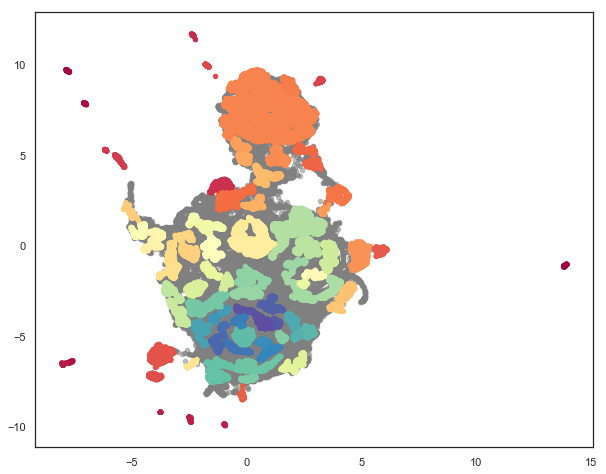

In [266]:
'''
HDBSCAN clusters in 2D
low min sample size seems to refuce unclustered data;
larger min cluster size decrease cluster numbers
'''
d2_labels = hdbscan.HDBSCAN(min_samples=50,min_cluster_size=100).fit_predict(d2_embedding)

sns.set(style='white', rc={'figure.figsize':(10,8)})
clustered = (d2_labels >= 0)
plt.scatter(d2_embedding[~clustered, 0],
            d2_embedding[~clustered, 1],
            c=(0.5, 0.5, 0.5),
            s=20,
            alpha=0.5)
plt.scatter(d2_embedding[clustered, 0],
            d2_embedding[clustered, 1],
            c=d2_labels[clustered],
            s=20,
            cmap='Spectral');

In [271]:
'''
HDBSCAN clusters in 3D
low min sample size seems to refuce unclustered data;
larger min cluster size decrease cluster numbers
PCA reduction might not be a good idea because shape space is non-linear and the linear reduction could distort distances and later clustering
'''
d3_labels = hdbscan.HDBSCAN(min_samples=50,min_cluster_size=100).fit_predict(d3_embedding)

import plotly.graph_objects as go
fig = go.Figure()
size = 2
for cluster in set(d3_labels):
    clustered = (d3_labels == cluster)
    fig.add_trace(go.Scatter3d(
        x=d3_embedding[clustered,0],  # <-- Put your data instead
        y=d3_embedding[clustered,1],  # <-- Put your data instead
        z=d3_embedding[clustered,2],  # <-- Put your data instead
        name="cluster "+str(cluster),
        mode="markers",
        marker=dict(color=cluster+1,size=size, opacity=0.5)
    ))
fig.update_layout(title_text="HDBSCAN clusters in 3D",title_font_size=30)
fig.show()
##########
clustered = (d3_labels >= 0)
print('The percentage of clustered data points is '+str(np.sum(clustered) *1.0/ data.shape[0]*100)+'%')


/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13

/home/garner1/.local/lib/python2.7/site-packages/sklearn/externals/joblib/parallel.py:268: DeprecationWarning:

check_pickle is deprecated in joblib 0.12 and will be removed in 0.13



The percentage of clustered data points is 99.90080473901867%


In [272]:
new = (np.asarray(target) == 4)
from itertools import compress
List = zip(list(compress(cell_labels, new)),list(d2_labels[new])) #merge cell_id and cluster_id

from collections import defaultdict
d = defaultdict(list)
for k, v in List: d[k].append(v) #group the cluster_id by cell_id
# print(tuple(d.items()))

from collections import Counter

# import statistics 
# from statistics import mode 
# def most_common(List): 
#     return(mode(List)) 

cluster_id = []
for List in d.values():
#     cluster_id.append(most_common(List)) 
    c = Counter(List)
    cluster_id.append(c.most_common(1)[0][0])
# print cluster_id

In [273]:
import string 

def nochar(blabla):
    all = string.maketrans('','')
    nodigs = all.translate(all, string.digits)
    return blabla.translate(all, nodigs)

ind = 0
image_cluster = []

for img in os.listdir(folder_path)[:num_unique_cells]:
    image_cluster.append((int(nochar(img)),cluster_id[ind]))
    ind += 1
# print image_cluster
# print cluster_id

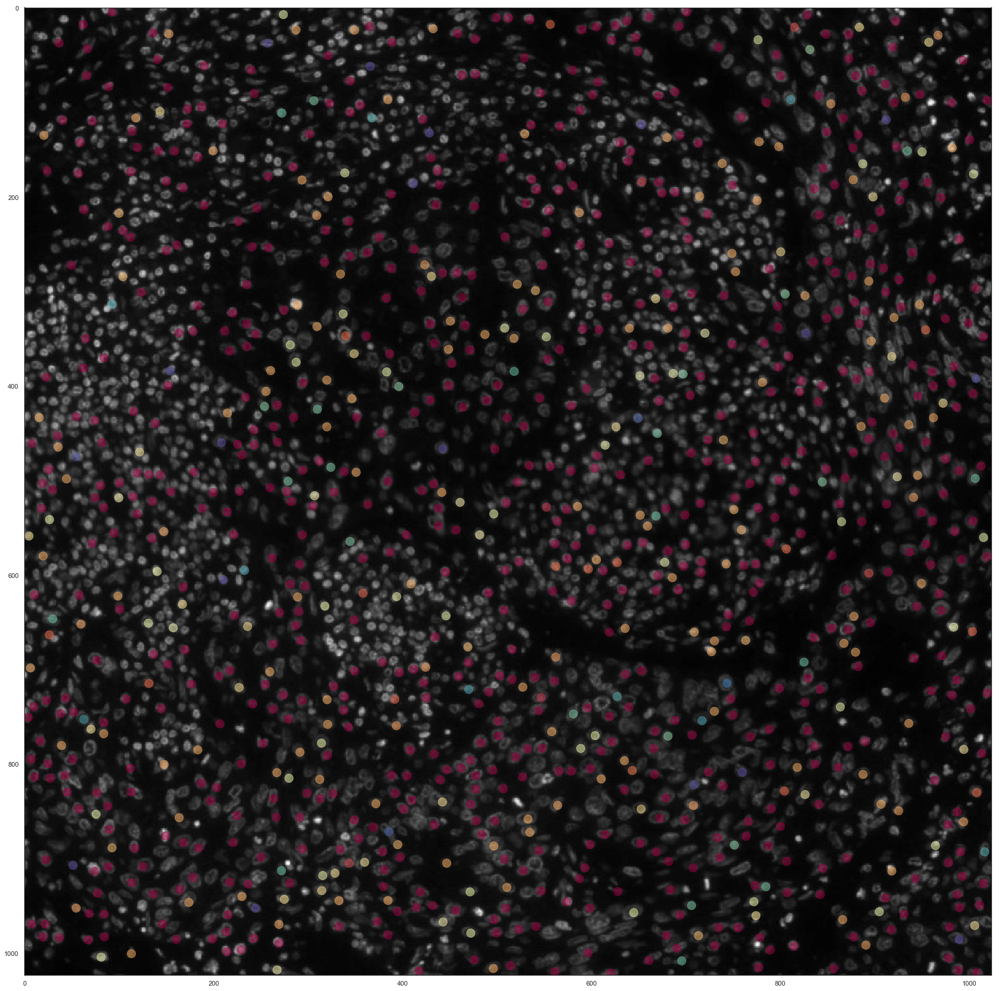

In [274]:
import csv
with open('/home/garner1/Work/dataset/cellImages/image52/properties.csv', 'r') as f:
    properties = list(csv.reader(f, delimiter=','))
properties = np.array(properties)

image = imageio.imread('/home/garner1/Work/dataset/cellImages/image52/iMS266_20190426_001.sub52.jpg')
sns.set(style='white', rc={'figure.figsize':(50,30)})
images_selection = [k for k,v in image_cluster]
plt.scatter(properties[images_selection,1].astype(np.float),
            properties[images_selection,2].astype(np.float),
            c=np.asarray(cluster_id),
            s=200,
            cmap='Spectral',
            alpha=0.5);
plt.imshow(image,cmap='gray')
plt.show()
# plt.axis('off')

In [53]:
'''Get the node2vec representation of the centroid from each segmented cell. 
Use it together with the intensity array as input for the UMAP dimensionality reduction.
Spatial contect + local intensity information'''

(1024, 1024)

In [33]:
np.savetxt("clusters.csv", d3_labels.astype(int), delimiter=",", fmt='%i')